# Домашняя работа №2 по дисциплине «МОВС: Компьютерное зрение» 

<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">

Выполнил:  
**Вольхин Данил Федорович**

Email:  
[dfvolkhin@edu.hse.ru](mailto:dfvolkhin@edu.hse.ru)

Дата:  
**4 февраля 2025**

<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">

😊 Первый раз в жизни делаю посадку на юпитер 😊

## ANSI коды для цветов текста

In [1]:
RED = "\033[31m"
GREEN = "\033[32m"
YELLOW = "\033[33m"
BLUE = "\033[34m"
RESET = "\033[0m"  # сброс цветов до стандартных

## Шаблоны markdown

<span style="color: green;"># Это комментарий в коде</span><br>
<span style="color: blue;">def</span> greet(name):<br>
<span style="color: red;">print</span>(f"Hello, {name}!")
<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">
<pre style="background-color: #F5F5F5; padding: 10px; border-radius: 5px; font-family: monospace;">code</pre>

## Установка библиотек (опционально)

In [2]:
# !pip install torch==1.12.1+cu116 torchvision==0.13.1+cu116 --index-url https://download.pytorch.org/whl/cu116
# !pip install tensorboard==2.10.1 tensorflow==2.10.0
# !pip install pydantic==2.10.3
# !pip install tqdm==4.66.2
# !pip install scikit-learn==1.5.1
# !pip install scipy==1.13.1
# !pip install seaborn==0.13.2
# !pip install rich==13.7.1
# !pip install requests==2.32.3
# !pip install pillow==10.4.0
# !pip install pandas==2.2.2
# !pip install matplotlib==3.9.2
# !pip install duckdb==1.1.0
# !pip install annotated-types==0.7.0

# Подготовка к написанию кода

## Импорт библиотек

In [3]:
print(f"{YELLOW}"+60*"-"+f"{RESET}")
print(f"Библиотеки: \n")

# Дополнительные библиотеки
import platform # Узнать версию пайтона ;)
import os
import logging
import time
import sys
import random
import re
import shutil
from tqdm import tqdm
from functools import wraps
from typing import Any, Tuple, Union, Optional, List, Type, Callable, Dict
from collections import Counter
import zipfile
from dataclasses import dataclass
import yaml
from glob import glob
from pathlib import Path
import random

# Основные библиотеки
import IPython.display as ipd # Добавляет виджеты для ячеек юпитера
from IPython import get_ipython
import ipykernel
print(f"python: {BLUE}{platform.python_version()}{RESET} ")
import matplotlib # Для рисунков
import matplotlib.pyplot as plt
print(f"matplotlib: {BLUE}{matplotlib.__version__}{RESET}")
import numpy as np # Для работы с массивами
print(f"numpy: {BLUE}{np.__version__}{RESET}")
import pandas as pd # Работа с таблицами
print(f"pandas: {BLUE}{pd.__version__}{RESET}")
import sklearn # Много полезного для ML
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
print(f"sklearn: {BLUE}{sklearn.__version__}{RESET}")
import scipy
print(f"scipy: {BLUE}{scipy.__version__}{RESET}")
import pydantic # Для валидации данных
from pydantic import (BaseModel, Field, StrictStr, condecimal, StrictInt, StrictBool,
                      FilePath, DirectoryPath, ValidationError, root_validator, ConfigDict)
print(f"pydantic: {BLUE}{pydantic.__version__}{RESET}")
import fastapi
from fastapi import HTTPException, status
print(f"fastapi: {BLUE}{fastapi.__version__}{RESET}")
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, Subset, WeightedRandomSampler
print(f"torch: {BLUE}{torch.__version__}{RESET}")
import torchvision
from torchvision import datasets
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import torchvision.models as models
from torchvision.ops import box_iou
print(f"torchvision: {BLUE}{torchvision.__version__}{RESET}")
import requests
print(f"requests: {BLUE}{requests.__version__}{RESET}")
import PIL
from PIL import Image
print(f"pillow: {BLUE}{PIL.__version__}{RESET}")
import ultralytics
from ultralytics import YOLO
print(f"ultralytics: {BLUE}{ultralytics.__version__}{RESET}")
from roboflow import Roboflow
import cv2
print(f"opencv: {BLUE}{cv2.__version__}{RESET}")
import seaborn as sns
print(f"seaborn: {BLUE}{sns.__version__}{RESET}")
import albumentations as A
print(f"albumentations: {BLUE}{A.__version__}{RESET}")


from rich.theme import Theme
from rich.logging import RichHandler
from rich.console import Console
from rich.pretty import install as pretty_install
from rich.traceback import install as traceback_install


print(f"{YELLOW}"+60*"-"+f"{RESET}")

------------------------------------------------------------
Библиотеки: 

python: 3.9.16 
matplotlib: 3.9.2
numpy: 1.26.4
pandas: 2.2.2
sklearn: 1.5.1
scipy: 1.13.1
pydantic: 2.10.3
fastapi: 0.115.7
torch: 2.6.0+cu118
torchvision: 0.21.0+cu118
requests: 2.32.3
pillow: 10.4.0
ultralytics: 8.3.71
opencv: 4.10.0
seaborn: 0.13.2
albumentations: 2.0.3
------------------------------------------------------------


## Дополнительные настройки

In [4]:
import warnings
warnings.filterwarnings("ignore")
import logging
# Отключение логирования для cmdstanpy
logging.getLogger('cmdstanpy').setLevel(logging.ERROR)
# Полезна при разработке собственных библиотек, юпитер будет переимпортировать модули, если в них были изменения
%load_ext autoreload
%autoreload 1

## Кастомный setup_logging

In [5]:
log = None

def setup_logging(clean=False, debug=False):
    global log

    if log is not None:
        return log

    try:
        if clean and os.path.isfile('setup.log'):
            os.remove('setup.log')
        time.sleep(0.1)  # prevent race condition
    except:
        pass

    if sys.version_info >= (3, 9):
        logging.basicConfig(level=logging.DEBUG, format='%(asctime)s | %(levelname)s | %(pathname)s | %(message)s',
                            filename='setup.log', filemode='a', encoding='utf-8', force=True)
    else:
        logging.basicConfig(level=logging.DEBUG, format='%(asctime)s | %(levelname)s | %(pathname)s | %(message)s',
                            filename='setup.log', filemode='a', force=True)

    console = Console(log_time=True, log_time_format='%H:%M:%S-%f', theme=Theme({
        "traceback.border": "black",
        "traceback.border.syntax_error": "black",
        "inspect.value.border": "black",
    }))
    pretty_install(console=console)
    traceback_install(console=console, extra_lines=1, width=console.width, word_wrap=False, indent_guides=False,
                      suppress=[])
    rh = RichHandler(show_time=True, omit_repeated_times=False, show_level=True, show_path=False, markup=False,
                     rich_tracebacks=True, log_time_format='%H:%M:%S-%f',
                     level=logging.DEBUG if debug else logging.INFO, console=console)
    rh.set_name(logging.DEBUG if debug else logging.INFO)
    log = logging.getLogger("sd")
    log.addHandler(rh)

    return log

In [6]:
log = setup_logging()

## Валидация входящих данных для каждого класса

### validate_with_pydantic

In [7]:
def validate_with_pydantic(model_cls):
    """
    Декоратор для валидации данных с использованием Pydantic-модели.
    """

    def decorator(func):
        @wraps(func)
        def wrapper(*args, **kwargs):
            # Проверяем данные в аргументах функции
            try:
                data = kwargs.get("entry", args[0] if args else None)
                if not data:
                    raise HTTPException(status_code=status.HTTP_400_BAD_REQUEST,
                                        detail="No data provided for validation.")
                # Валидация данных
                if isinstance(data, BaseModel):
                    data = data.dict(by_alias=True)
                validated_data = model_cls(**data)
                # Передаем валидированные данные дальше
                kwargs["entry"] = validated_data
                return func(*args, **kwargs)
            except ValidationError as ve:
                log.exception("Validation failed", exc_info=ve)
                raise HTTPException(status_code=status.HTTP_400_BAD_REQUEST,
                                    detail="Invalid data for Pydantic model.") from ve

        return wrapper

    return decorator

### auto_generate_docstring

In [8]:
def auto_generate_docstring(cls: Type[BaseModel]) -> Type[BaseModel]:
    """
    Декоратор для автоматического добавления docstring в классы Pydantic.
    """

    def generate_docstring(model: Type[BaseModel]) -> str:
        """
        Генерация строки документации из описания полей модели Pydantic.
        """
        docstring = []
        for field_name, field_info in model.__fields__.items():
            field_details = f"Field '{field_name}':\n"
            if field_info.description:  # Получение описания
                field_details += f"  Description: {field_info.description}\n"
            if field_info.examples:  # Получение примеров
                field_details += f"  Examples: {field_info.examples}\n"
            docstring.append(field_details)
        return "\n".join(docstring)

    # Добавляем описание к существующему docstring
    cls.__doc__ = (cls.__doc__ or "") + "\n\n" + generate_docstring(cls)
    return cls

### EntryRoboflowDatasetDownloader

In [9]:
@auto_generate_docstring
class EntryRoboflowDatasetDownloader(BaseModel):
    """
    Класс для валидации входных данных конфигурации загрузки датасета из Roboflow
    """
    model_config = ConfigDict(arbitrary_types_allowed=True)
    
    ApiKey: StrictStr = Field(...,
                             alias="api_key",
                             examples=["7fwRxe7BbpO6YkhH7dW7"],
                             description="API ключ для доступа к Roboflow")
    
    Workspace: StrictStr = Field(...,
                                alias="workspace",
                                examples=["alexandre-b2d69"],
                                description="Название рабочего пространства в Roboflow")
    
    ProjectName: StrictStr = Field(...,
                                  alias="project_name",
                                  examples=["first-ugfem"],
                                  description="Название проекта в Roboflow")
    
    Version: StrictInt = Field(...,
                              alias="version",
                              examples=[1],
                              description="Версия датасета для загрузки")
    
    TargetDir: Optional[StrictStr] = Field("./dataset",
                                         alias="target_dir",
                                         examples=["./dataset"],
                                         description="Целевая директория для сохранения датасета")
    
    FormatType: Optional[StrictStr] = Field("yolov9",
                                          alias="format_type",
                                          examples=["yolov9"],
                                          description="Формат аннотаций для загрузки датасета")
    
    Overwrite: Optional[bool] = Field(True,
                                     alias="overwrite",
                                     examples=[True],
                                     description="Перезаписывать существующие файлы при загрузке")

# Roboflow

## Загрузка и распаковка набора данных first-ugfem

### Класс RoboflowDatasetDown

In [10]:
@dataclass
class RoboflowDatasetDownloader:
    entry: EntryRoboflowDatasetDownloader

    def __post_init__(self):
        # Распаковка параметров
        self.api_key = self.entry.ApiKey
        self.workspace = self.entry.Workspace
        self.project_name = self.entry.ProjectName
        self.version = self.entry.Version
        self.target_dir = self.entry.TargetDir
        self.format_type = self.entry.FormatType
        self.overwrite = self.entry.Overwrite
        # Проверка существования таргетной директории
        self._ensure_target_dir()

    def _ensure_target_dir(self):
        os.makedirs(self.target_dir, exist_ok=True)

    def download(self) -> str:
        try:
            rf = Roboflow(api_key=self.api_key)
            project = rf.workspace(self.workspace).project(self.project_name)
            version = project.version(self.version)
        except Exception as ex:
            log.error("Не удалось подключиться к проетку", exc_info=ex)
        
        return version.download(
            self.format_type,
            location=self.target_dir, 
            overwrite=self.overwrite
        )

### Распаковка

In [17]:
# Качаем данные
downloader = validate_with_pydantic(EntryRoboflowDatasetDownloader)(RoboflowDatasetDownloader)(
    entry = {
         "api_key": "7fwRxe7BbpO6YkhH7dW7",
         "workspace": "alexandre-b2d69",
         "project_name": "first-ugfem",
         "version": 1,
         "target_dir": "./dataset"   
    }
)
    
dataset = downloader.download()
log.info(f"Dataset downloaded to: {dataset.location}")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to ./dataset in yolov9:: 100%|████████████████████| 1610/1610 [00:00<00:00, 2960.22it/s]


02:35:58-642002 INFO     Dataset downloaded to: C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset

## Просмотр содержимого

### Функция analyze_dataset_structure

In [18]:
def analyze_dataset_structure(dataset, no_log: bool = False):
    config_path = os.path.join(dataset.location, "data.yaml")
    
    try:
        with open(config_path) as f:
            data_config = yaml.safe_load(f)
            if not no_log:
                log.info(f"Dataset Info: \n{data_config}")

        class_names = data_config.get('names', '')
        
        splits = {
            'train': data_config.get('train', ''), 
            'test': data_config.get('test', ''),
            'val': data_config.get('val', '')
        }
        
        total_images = 0
        result = {}
        
        for split_name, relative_path in splits.items():
            if not relative_path:
                continue
                
            # Полный путь к папке с изображениями
            full_images_path = os.path.join(
                dataset.location, 
                relative_path.split("./")[-1]
            )
            
            # Подсчет изображений
            if os.path.exists(full_images_path):
                images = glob(os.path.join(full_images_path, '*.jpg')) + \
                         glob(os.path.join(full_images_path, '*.png')) + \
                         glob(os.path.join(full_images_path, '*.jpeg'))
                
                count = len(images)
                result[split_name] = {
                    'path': full_images_path,
                    'images': count
                }
                total_images += count
            else:
                log.warning(f"Directory not found: {full_images_path}")
                result[split_name] = {
                    'path': full_images_path,
                    'images': 0
                }

        # Формирование отчета
        report = ["Dataset Structure Analysis:"]
        for split, info in result.items():
            report.append(
                f"{split.capitalize()}: {info['images']} images "
                f"at {info['path']}"
            )
            
        report.append(f"\nTotal images: {total_images}")
        if not no_log:
            log.info("\n".join(report))
        
        return result, total_images, class_names
        
    except Exception as e:
        log.error(f"Error analyzing dataset: {str(e)}")
        raise

### Анализ структуры датасета

In [19]:
split_info, total, class_names = analyze_dataset_structure(dataset)

02:35:58-677068 INFO     Dataset Info:                                                                             
                         {'names': ['airplane'], 'nc': 1, 'roboflow': {'license': 'CC BY 4.0', 'project':          
                         'first-ugfem', 'url':                                                                     
                         'https://universe.roboflow.com/alexandre-b2d69/first-ugfem/dataset/1', 'version': 1,      
                         'workspace': 'alexandre-b2d69'}, 'test': '../test/images', 'train': '../train/images',    
                         'val': '../valid/images'}

02:35:58-687179 INFO     Dataset Structure Analysis:                                                               
                         Train: 699 images at                                                                      
                         C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\train/images          
                         Test: 34 images at                                                                        
                         C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test/images           
                         Val: 66 images at                                                                         
                         C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\valid/images          
                                                                                                                   
                         Total images: 799

# Предварительная обработка данных и визуализация

## Визуализация

### Класс ImageVisualizer

In [20]:
class ImageVisualizer:
    def __init__(self, params):
        self.params = params
        self._validate_params()
        
        # Инициализация параметров
        self.imglist = params['imglist']
        self.subtitlelist = params['subtitlelist']
        self.title = params.get('title', '')
        self.figsize = params.get('figsize', (15, 5))
        self.rows = params.get('rows', 1)
        self.cols = params.get('cols', len(self.imglist))
        self.cmaps = params.get('cmaps', [])
        self.colorbars = params.get('colorbars', [])
        self.show_axis = params.get('show_axis', False)
        self.tight_layout = params.get('tight_layout', True)

    def _validate_params(self):
        if 'imglist' not in self.params or 'subtitlelist' not in self.params:
            raise ValueError("Требуются параметры 'imglist' и 'subtitlelist'")
            
        if len(self.params['imglist']) != len(self.params['subtitlelist']):
            raise ValueError("Количество изображений и подписей должно совпадать")

    def _convert_image(self, img):
        if isinstance(img, Image.Image):
            return np.array(img.convert('RGB'))
        elif isinstance(img, np.ndarray):
            if img.ndim == 3 and img.shape[2] == 3:
                return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            return img
        else:
            raise TypeError(f"Неподдерживаемый тип изображения: {type(img)}")

    def _auto_detect_cmap(self, image):
        if image.ndim == 2 or (image.ndim == 3 and image.shape[2] == 1):
            return 'jet'
        return None

    def visualize(self):
        plt.figure(figsize=self.figsize)
        
        if self.title:
            plt.suptitle(self.title, fontsize=14)

        for i, (img, subtitle) in enumerate(zip(self.imglist, self.subtitlelist)):
            # Конвертация изображения
            converted_img = self._convert_image(img)
            
            # Создание субплота
            plt.subplot(self.rows, self.cols, i+1)
            
            # Выбор цветовой карты
            cmap = self.cmaps[i] if i < len(self.cmaps) else self._auto_detect_cmap(converted_img)
            
            # Отображение изображения
            plt.imshow(converted_img, cmap=cmap)
            
            # Настройка заголовка и осей
            plt.title(subtitle)
            if not self.show_axis:
                plt.axis('off')
            
            # Добавление цветовой шкалы
            if i < len(self.colorbars) and self.colorbars[i]:
                plt.colorbar()

        if self.tight_layout:
            plt.tight_layout()
            
        plt.show()

### Класс Visualize

In [21]:
@dataclass
class Visualize:
    dataset: Any
    class_names: List[str] = None

    def __post_init__(self):
        self.split_info, self.total, self.class_names = analyze_dataset_structure(self.dataset, True)
        self.is_valid_path(self.dataset.location)
        if self.class_names is None:
            self.class_names = self._get_class_names()

    def _get_class_names(self):
        config_path = os.path.join(self.dataset.location, "data.yaml")
        with open(config_path) as f:
            data_config = yaml.safe_load(f)
        return data_config.get('names', [])

    @staticmethod
    def is_valid_path(path):
        if not os.path.exists(path):
            raise FileNotFoundError(f"Path not found: {path}")

    def ann(self, path_to_image: str, path_to_ann: str) -> np.ndarray:
        img = cv2.imread(path_to_image)
        if img is None:
            raise ValueError(f"Failed to read image: {path_to_image}")
            
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        h, w, _ = img.shape

        if not os.path.exists(path_to_ann):
            return img

        with open(path_to_ann, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) < 5:
                    continue

                cls_id, x_center, y_center, width, height = map(float, parts[:5])
                x_center *= w
                y_center *= h
                width *= w
                height *= h

                x1 = int(x_center - width/2)
                y1 = int(y_center - height/2)
                x2 = int(x_center + width/2)
                y2 = int(y_center + height/2)

                color = plt.cm.tab20(int(cls_id) % 20)[:3]
                color = [int(c * 255) for c in color]

                cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
                cv2.putText(img, 
                           f"{self.class_names[int(cls_id)]}", 
                           (x1 + 5, y1 + 20), 
                           cv2.FONT_HERSHEY_SIMPLEX, 
                           0.6, color, 2)
        return img

    def _get_annotations_count(self) -> Dict[str, Dict[str, int]]:
        counts = {}
        for split, info in self.split_info.items():
            ann_dir = Path(info['path']).parent / "labels"
            count = {cls_name: 0 for cls_name in self.class_names}
            
            for ann_file in ann_dir.glob("*.txt"):
                with open(ann_file, 'r') as f:
                    for line in f:
                        cls_id = line.strip().split()[0]
                        count[self.class_names[int(cls_id)]] += 1
            counts[split] = count
        return counts

    def _collect_bbox_statistics(self):
        self.bbox_stats = {}
        
        for split, info in self.split_info.items():
            ann_dir = Path(info['path']).parent / "labels"
            ann_files = list(ann_dir.glob("*.txt"))
            
            counts, sizes = self._count_bboxes_and_sizes(ann_files)
            
            self.bbox_stats[split] = {
                'counts': counts,
                'sizes': sizes
            }

    def _count_bboxes_and_sizes(self, annotation_files) -> tuple:
        bbox_counts = []
        relative_sizes = []

        for ann_file in annotation_files:
            with open(ann_file, 'r') as f:
                lines = f.readlines()
                if not lines:
                    continue

                bboxes = [list(map(float, line.split()[1:])) for line in lines]
                bbox_counts.append(len(bboxes))
                
                if len(bboxes) > 0:
                    sizes = [bbox[2]*bbox[3] for bbox in bboxes]  # width * height
                    relative_sizes.append(sum(sizes)/len(sizes))
                else:
                    relative_sizes.append(0.0)

        return bbox_counts, relative_sizes

    def visualize_ann(self, num_samples: int = 5, seed: int = 17, max_cols: int = 4, max_name_length = 18):
        random.seed(seed)
        
        for split, info in self.split_info.items():
            if split not in ['train', 'test', 'val']:
                continue
    
            image_files = list(Path(info['path']).glob("*.*"))
            if not image_files:
                continue
                
            selected = random.sample(image_files, min(num_samples, len(image_files)))
            num_images = len(selected)
            
            # Адаптивный расчет сетки
            cols = min(num_images, max_cols)
            rows = (num_images + cols - 1) // cols  # Округление вверх
            
            # Автоподбор размера фигуры
            fig_width = cols * 5
            fig_height = rows * 4 + 2  # +2 для заголовка

            imglist = []
            subtitlelist = []
            
            for img_path in selected:
                ann_path = img_path.parent.parent / "labels" / f"{img_path.stem}.txt"
                annotated_img = self.ann(str(img_path), str(ann_path))
                imglist.append(annotated_img)
                
                # Обработка названия файла
                filename = img_path.name
                if len(filename) > max_name_length:
                    # Обрезаем название и добавляем многоточие
                    filename = filename[:max_name_length - 3] + "..."
                
                subtitlelist.append(f"{split} | {filename}")
    
            params = {
                "imglist": imglist,
                "subtitlelist": subtitlelist,
                "title": f"Dataset samples ({split})",
                "colorbars": [False] * num_images,
                "figsize": (fig_width, fig_height),
                "cmaps": [None] * num_images,
                "cols": cols,
                "rows": rows,
                "show_axis": False
            }
            
            visualizer = ImageVisualizer(params)
            visualizer.visualize()

    def visualize_hist(self):
        counts = self._get_annotations_count()
        fig, axes = plt.subplots(1, len(counts), figsize=(20, 5))
        
        if len(counts) == 1:
            axes = [axes]

        for ax, (split, count_dict) in zip(axes, counts.items()):
            classes = list(count_dict.keys())
            values = list(count_dict.values())
            
            colors = plt.cm.tab20(np.arange(len(classes)) % 20)
            
            bars = ax.bar(classes, values, color=colors)
            ax.set_title(f'Class Distribution - {split.capitalize()}')
            ax.set_ylabel('Count')
            ax.tick_params(axis='x', rotation=45)
            
            for bar in bars:
                height = bar.get_height()
                ax.annotate(f'{height}',
                            xy=(bar.get_x() + bar.get_width() / 2, height - 0.2 * height),
                            xytext=(0, 3),
                            textcoords="offset points",
                            ha='center', va='bottom', 
                            rotation=90, color='white')

        plt.tight_layout()
        plt.show()

    def visualize_bbox_distribution(self):
        if not hasattr(self, 'bbox_stats'):
            self._collect_bbox_statistics()

        # Создаем DataFrame
        data = {'Split': [], 'Bounding Boxes': []}
        for split, stats in self.bbox_stats.items():
            data['Split'].extend([split]*len(stats['counts']))
            data['Bounding Boxes'].extend(stats['counts'])
            
        df = pd.DataFrame(data)

        # Визуализация
        plt.figure(figsize=(12, 6))
        sns.histplot(
            data=df, 
            x='Bounding Boxes', 
            hue='Split', 
            multiple='stack',
            kde=True,
            bins=20
        )
        plt.title('Распределение количества bounding boxes на изображение')
        plt.xlabel('Количество bounding boxes')
        plt.ylabel('Частота')
        plt.show()

    def visualize_bbox_size_distribution(self):
        if not hasattr(self, 'bbox_stats'):
            self._collect_bbox_statistics()

        # Создаем DataFrame
        data = {'Split': [], 'Relative Size': []}
        for split, stats in self.bbox_stats.items():
            data['Split'].extend([split]*len(stats['sizes']))
            data['Relative Size'].extend(stats['sizes'])
            
        df = pd.DataFrame(data)

        # Визуализация
        plt.figure(figsize=(12, 6))
        sns.boxplot(
            x='Split',
            y='Relative Size',
            data=df,
            showfliers=False,
            palette='Set2'
        )
        plt.title('Распределение относительных размеров bounding boxes')
        plt.ylabel('Относительный размер (width × height)')
        plt.xlabel('Сплит')
        plt.show()

In [22]:
visualizer = Visualize(dataset)

### Визуализация аннотаций

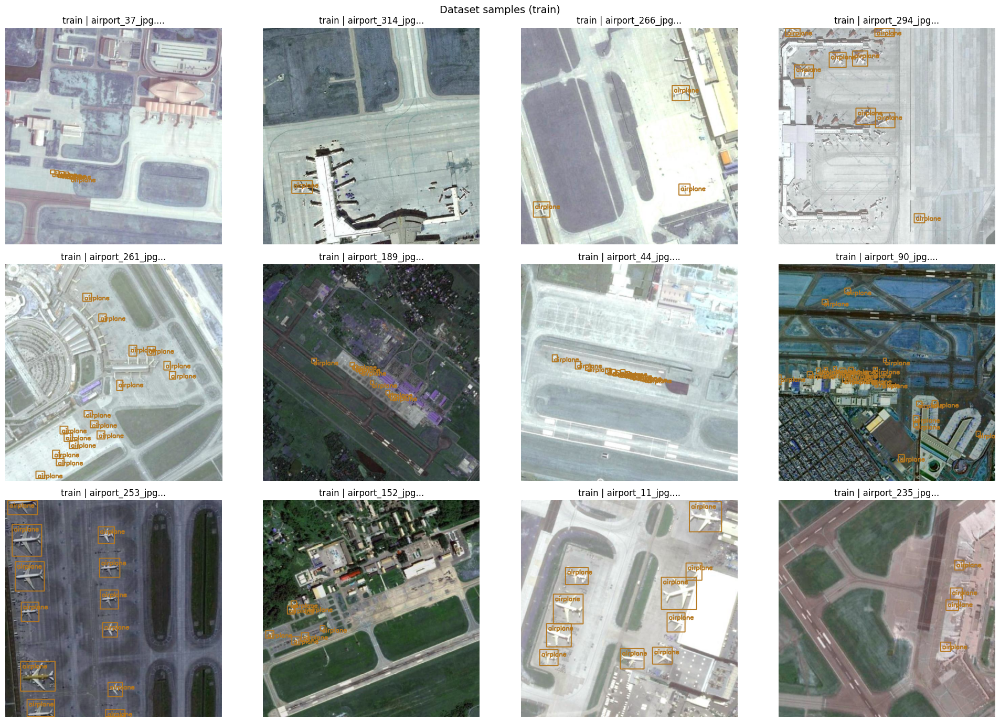

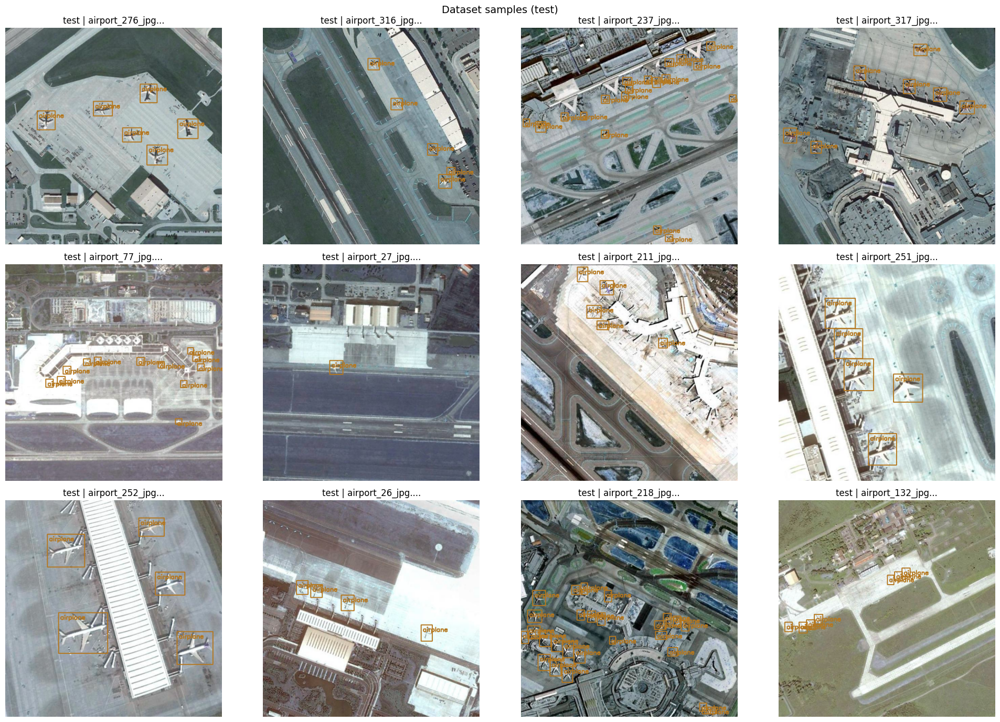

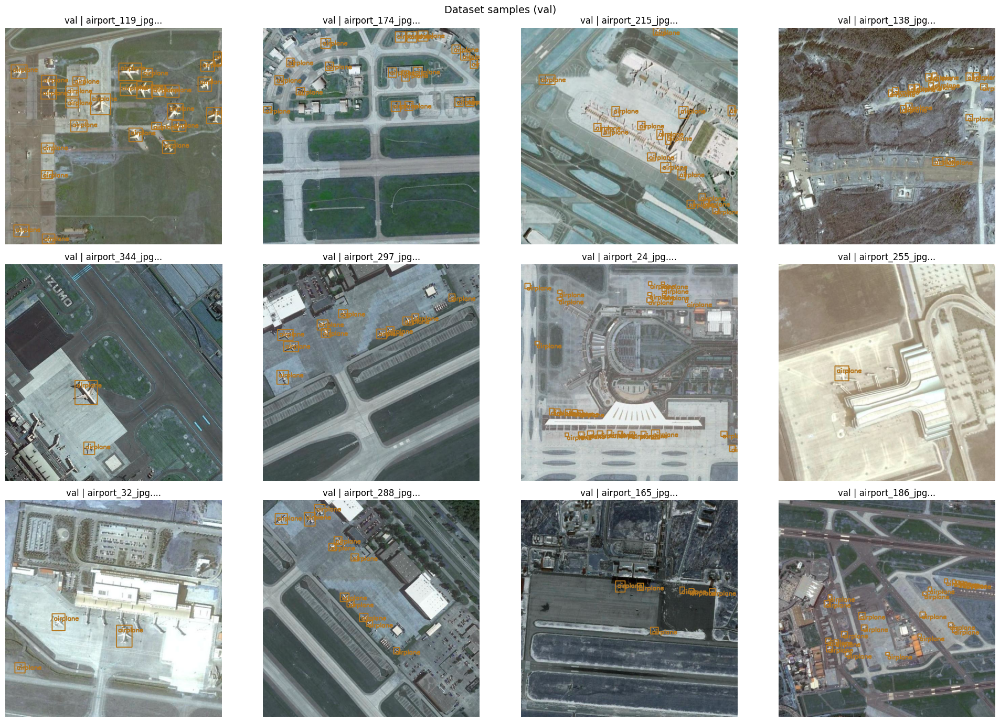

In [23]:
# Визуализация аннотаций
visualizer.visualize_ann(num_samples=12)

### Визуализация гистограммы

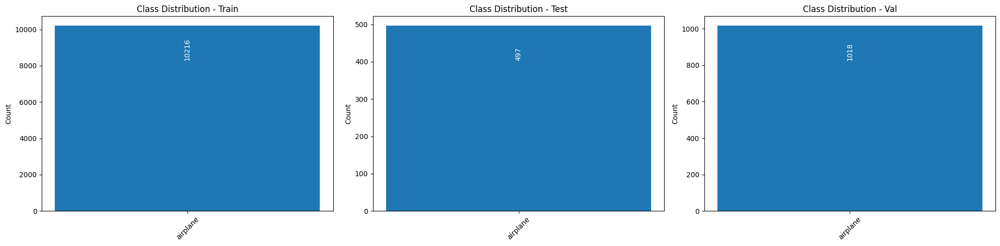

In [24]:
# Визуализация гистограмм распределения классов
visualizer.visualize_hist()

### Визуализация распределения количества bounding boxes

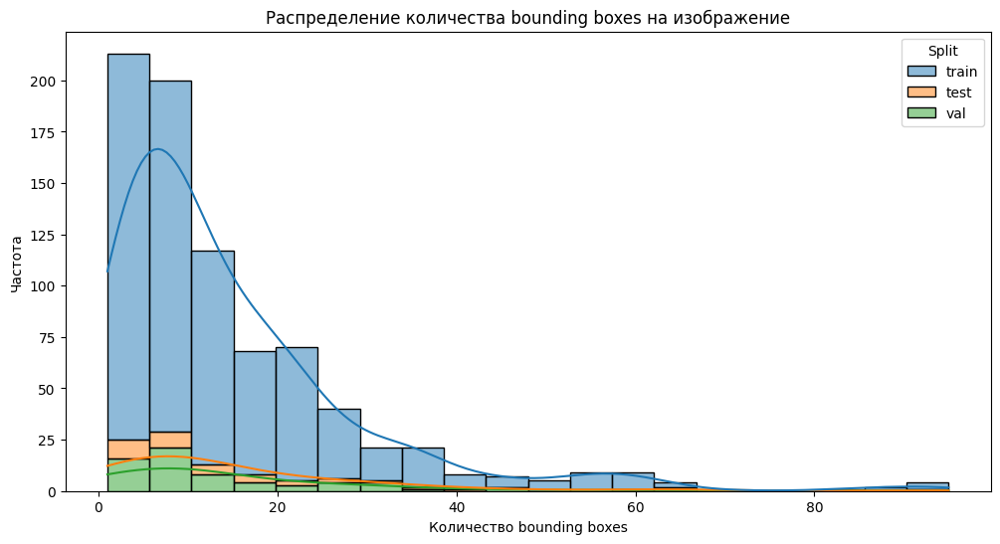

In [25]:
# Визуализация распределения количества боксов
visualizer.visualize_bbox_distribution()

### Визуализация распределения размеров bounding boxes

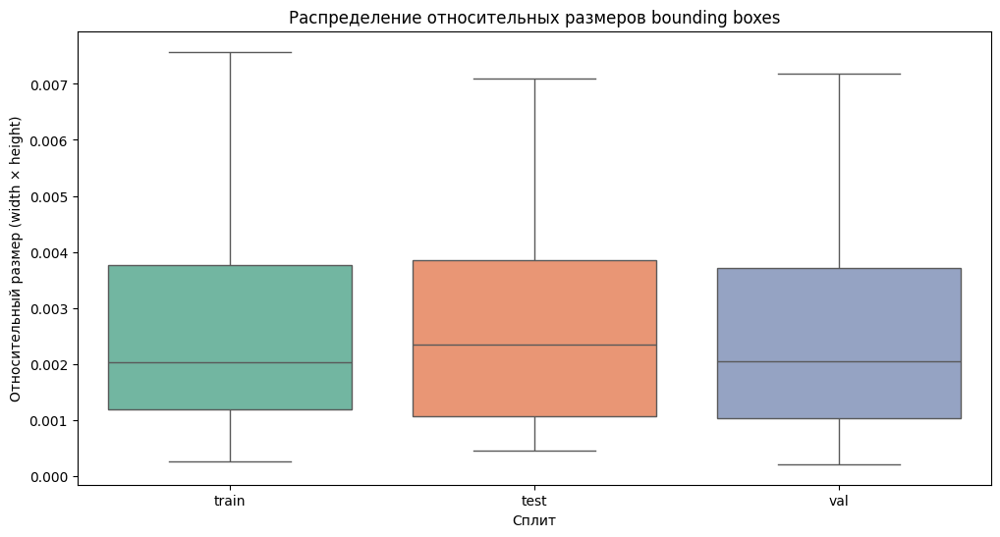

In [26]:
# Визуализация распределения размеров боксов
visualizer.visualize_bbox_size_distribution()

# Дополнительный функционал для корректной работы аугментации

In [27]:
def preprocess(image_name, image_dir, label_dir):
    image_path = os.path.sep.join([image_dir, image_name])

    name = image_name.split('.jpg')[0]
    label_name = name + '.txt'
    label_path = os.path.sep.join([label_dir, label_name])

    return image_path, label_path, label_name

def draw_rect(img, bboxes, class_labels):
    colors = {0: (255,0,0)}

    img = img.copy()
    height, width = img.shape[:2]
    for bbox, cls in zip(bboxes, class_labels):
        center_x, center_y, w, h = bbox[0], bbox[1], bbox[2], bbox[3]
        x = int((center_x - w/2) * width)
        w = int(w * width)
        y = int((center_y - h/2) * height)
        h = int(h * height)

        color = colors[int(cls)]

        img = cv2.rectangle(img, (x, y), (x+w, y+h), color, 1)
    return img

def read_img(image_path, cvt_color=True):
    img = cv2.imread(image_path)
    if cvt_color:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

def save_img(image, save_path, jpg_quality=None):
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    if jpg_quality:
        cv2.imwrite(save_path, image, [int(cv2.IMWRITE_JPEG_QUALITY), jpg_quality])
    else:
        cv2.imwrite(save_path, image)

def display_img(image_path, label_path):
    img = read_img(image_path, cvt_color=False)
    bboxes, class_labels = read_label(label_path)
    img = draw_rect(img, bboxes, class_labels)

    return img[...,::-1]

def read_label(label_path):
    with open(label_path) as f:
        conts = f.readlines()

    bboxes = []
    class_labels = []
    for cont in conts:
        cont = cont.strip().split()

        center_x, center_y, w, h = float(cont[1]), float(cont[2]), float(cont[3]), float(cont[4])
        bboxes.append([center_x, center_y, w, h])
        class_labels.append(cont[0])
    return (bboxes, class_labels)

def save_label(bboxes, class_labels, label_path):
    tem_lst = []
    for i, bbox in enumerate(bboxes):
        tem_lst.append(class_labels[i] + ' ' + str(bbox[0]) + ' ' + str(bbox[1]) + ' ' + str(bbox[2]) + ' ' + str(bbox[3]) + '\n')

    with open(label_path, 'w') as f:
        f.writelines(tem_lst)

# Реализация аугментации Mosaic

## Реализация mosaic

### Функция для рандомного кропа изображения с учётом ббоксов

In [28]:
def random_crop_savebboxes(image_name, image_dir, label_dir, expected_h, expected_w):
    image_path, label_path, _ = preprocess(image_name, image_dir, label_dir)
    (bboxes, class_labels) = read_label(label_path)

    # Исправленный трансформ с явным указанием параметров
    transform = A.Compose([
        A.RandomResizedCrop(
            size=(expected_h, expected_w),
            scale=(0.08, 1.0),  # диапазон масштабирования
            ratio=(0.75, 1.33), # диапазон соотношения сторон
            interpolation=1,    # INTER_LINEAR
            p=1.0               # вероятность применения
        )
    ], bbox_params=A.BboxParams(
        format='yolo',
        label_fields=['class_labels'],
        min_area=1,
        min_visibility=0.1
    ))

    transformed = transform(
        image=read_img(image_path),
        bboxes=bboxes,
        class_labels=class_labels
    )
    
    return transformed['image'], transformed['bboxes'], transformed['class_labels']

### Функция mosaic

In [29]:
def mosaic(image_file_list, image_dir, label_dir, output_image_dir, output_label_dir, scale_x, scale_y):
    # Создаем новое изображение размером (640,640,3)
    new_img = np.zeros((640, 640, 3), dtype=np.uint8)

    # Находим центральную точку мозаики
    div_point_x = int(640 * scale_x)
    div_point_y = int(640 * scale_y)

    # Инициализируем списки для новых ббоксов и классов
    all_bboxes = []
    all_classes = []

    # Итерируемся по нашим изображениям
    for i in range(len(image_file_list)):
        # Левое верхнее изображение, img_0
        if i == 0:
            w0 = div_point_x
            h0 = div_point_y
            img_0, bboxes_0, class_labels_0 = random_crop_savebboxes(image_file_list[0], image_dir, label_dir, h0, w0)
            new_img[:div_point_y, :div_point_x, :] = img_0

            # Преобразование ббоксов
            for box in bboxes_0:
                x_center = box[0] * scale_x
                y_center = box[1] * scale_y
                width = box[2] * scale_x
                height = box[3] * scale_y
                all_bboxes.append([x_center, y_center, width, height])
            all_classes.extend(class_labels_0)

        # Верхнее правое изображение, img_1
        elif i == 1:
            w1 = 640 - div_point_x
            h1 = div_point_y
            img_1, bboxes_1, class_labels_1 = random_crop_savebboxes(image_file_list[1], image_dir, label_dir, h1, w1)
            new_img[:div_point_y, div_point_x:, :] = img_1

            # Преобразование ббоксов
            for box in bboxes_1:
                x_center = box[0] * (1 - scale_x) + scale_x
                y_center = box[1] * scale_y
                width = box[2] * (1 - scale_x)
                height = box[3] * scale_y
                all_bboxes.append([x_center, y_center, width, height])
            all_classes.extend(class_labels_1)

        # Нижнее левое изображение, img_2
        elif i == 2:
            w2 = div_point_x
            h2 = 640 - div_point_y
            img_2, bboxes_2, class_labels_2 = random_crop_savebboxes(image_file_list[2], image_dir, label_dir, h2, w2)
            new_img[div_point_y:, :div_point_x, :] = img_2

            # Преобразование ббоксов
            for box in bboxes_2:
                x_center = box[0] * scale_x
                y_center = box[1] * (1 - scale_y) + scale_y
                width = box[2] * scale_x
                height = box[3] * (1 - scale_y)
                all_bboxes.append([x_center, y_center, width, height])
            all_classes.extend(class_labels_2)

        # Нижнее правое изображение, img_3
        else:
            w3 = 640 - div_point_x
            h3 = 640 - div_point_y
            img_3, bboxes_3, class_labels_3 = random_crop_savebboxes(image_file_list[3], image_dir, label_dir, h3, w3)
            new_img[div_point_y:, div_point_x:, :] = img_3

            # Преобразование ббоксов
            for box in bboxes_3:
                x_center = box[0] * (1 - scale_x) + scale_x
                y_center = box[1] * (1 - scale_y) + scale_y
                width = box[2] * (1 - scale_x)
                height = box[3] * (1 - scale_y)
                all_bboxes.append([x_center, y_center, width, height])
            all_classes.extend(class_labels_3)

    # Собираем все классы и ббоксы
    new_class_labels = all_classes
    new_bboxes = all_bboxes

    # Сохраняем результаты
    image_store_path = os.path.join(output_image_dir, 'mosaic.jpg')
    label_store_path = os.path.join(output_label_dir, 'mosaic.txt')
    
    save_img(new_img, image_store_path)
    save_label(new_bboxes, new_class_labels, label_store_path)
    
    return display_img(image_store_path, label_store_path)

## Создаем папки для хранения аугментированных изображений и соответствующих аннотаций

In [30]:
output_image_dir = 'augmentation/mosaic_images'
if not os.path.exists(output_image_dir):
    os.makedirs(output_image_dir)

output_label_dir = 'augmentation/mosaic_labels'
if not os.path.exists(output_label_dir):
    os.makedirs(output_label_dir)

# Пути до оригинальных изображений и аннотаций
image_dir = 'datasets/test/images/'
label_dir = 'datasets/test/labels/'

## Проверка работы mosaic

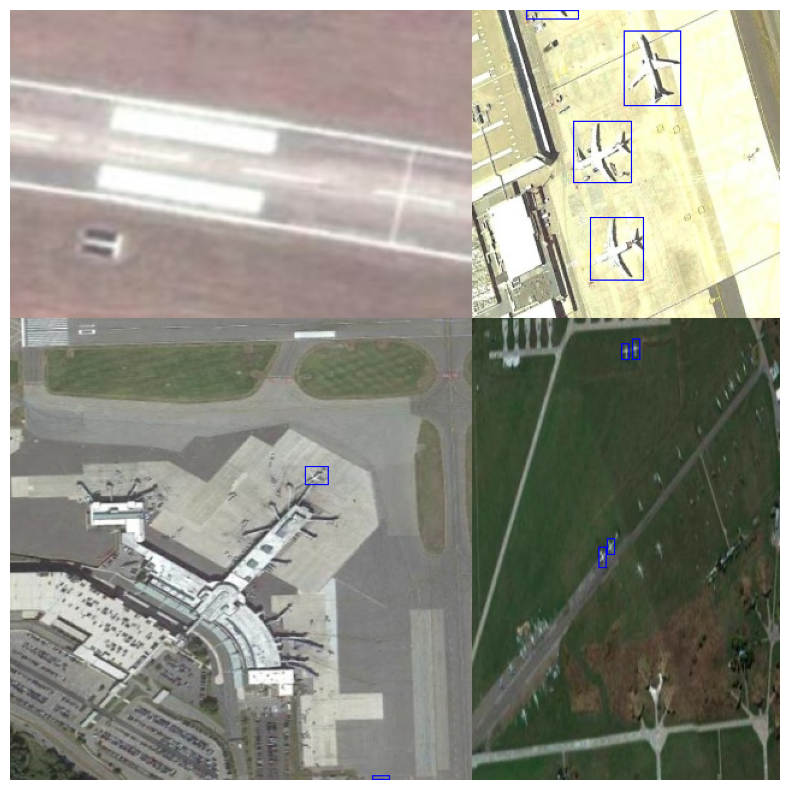

In [31]:
# Пути к данным
dataset_path = "./dataset"
train_image_dir = os.path.join(dataset_path, "train/images")
output_image_dir = os.path.join("./augmentation/mosaic_images/")
output_label_dir = os.path.join("./augmentation/mosaic_labels/")

# Получаем список всех изображений в тренировочном наборе
all_images = [f for f in os.listdir(train_image_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

# Рандомно выбираем 4 изображения
image_file_list = random.sample(all_images, 4)

# Параметры мозаики
scale_x = 0.6
scale_y = 0.4

# Выполняем аугментацию
res = mosaic(
    image_file_list=image_file_list,
    image_dir=train_image_dir,
    label_dir=os.path.join(dataset_path, "train/labels"),
    output_image_dir=output_image_dir,
    output_label_dir=output_label_dir,
    scale_x=scale_x,
    scale_y=scale_y
)

# Визуализация результата
plt.figure(figsize=(10, 10))
plt.imshow(res)
plt.axis('off')
plt.show()

# Реализация аугментации Mixup

## Функция Mixup

In [32]:
def mixup_augmentation(image_path1, annotation_path1, image_path2, annotation_path2, mixup_alpha=0.7):
    # Загрузите изображения и аннотации
    image1 = read_img(image_path1)
    image2 = read_img(image_path2)
    bboxes1, class_labels1 = read_label(annotation_path1)
    bboxes2, class_labels2 = read_label(annotation_path2)

    # Вычислите λ из бета-распределения
    lambda_value = np.random.beta(mixup_alpha, mixup_alpha)
    
    # Создайте миксап изображение с преобразованием в uint8
    mixup_image = (lambda_value * image1 + (1 - lambda_value) * image2).astype(np.uint8)

    # Комбинирование аннотаций
    mixup_bboxes = bboxes1 + bboxes2
    mixup_labels = class_labels1 + class_labels2

    return mixup_image, mixup_bboxes, mixup_labels

## Проверка работы Mixup

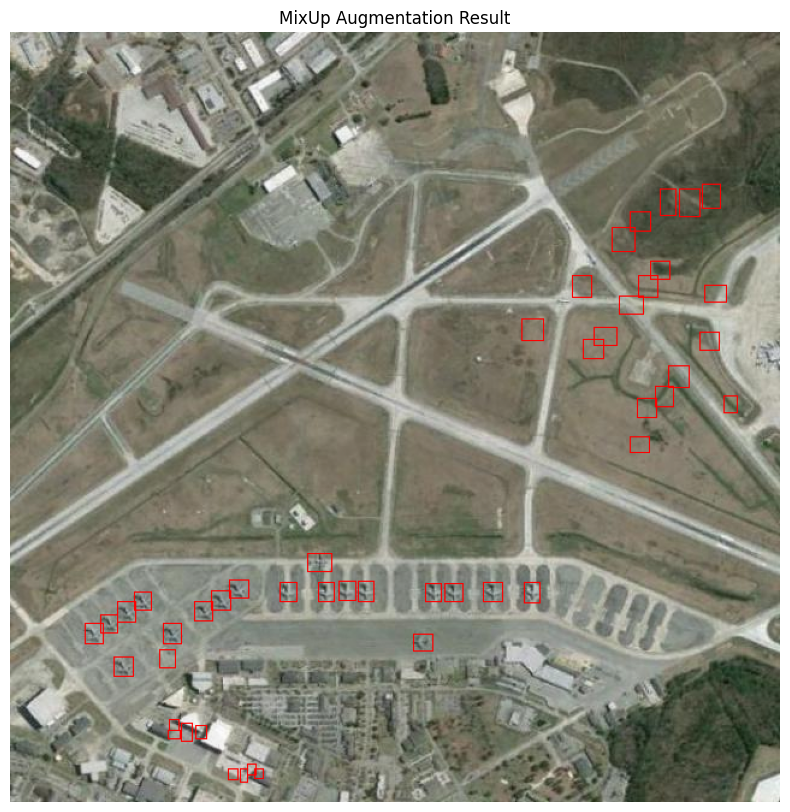

In [33]:
# Пути к тестовым данным
test_image_dir = os.path.join(dataset_path, "test/images")
test_label_dir = os.path.join(dataset_path, "test/labels")

# Получаем список тестовых изображений и аннотаций
test_images = [
    os.path.join(test_image_dir, f) 
    for f in os.listdir(test_image_dir) 
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
]

test_annotations = [
    os.path.join(test_label_dir, f.replace('.jpg', '.txt').replace('.png', '.txt'))
    for f in os.listdir(test_image_dir)
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
]

# Теперь можно использовать test_images и test_annotations
image_path1 = test_images[0]
annotation_path1 = test_annotations[0]
image_path2 = test_images[1]
annotation_path2 = test_annotations[1]

# Выполняем аугментацию MixUp
mixup_image, mixup_bboxes, mixup_labels = mixup_augmentation(
    image_path1=image_path1,
    annotation_path1=annotation_path1,
    image_path2=image_path2,
    annotation_path2=annotation_path2,
    mixup_alpha=0.7
)

# Отрисовываем аннотации на аугментированном изображении
res = draw_rect(mixup_image.copy(), mixup_bboxes, mixup_labels)

# Визуализируем результат
plt.figure(figsize=(10, 10))
plt.imshow(res)
plt.axis('off')
plt.title('MixUp Augmentation Result')
plt.show()

# Базовое обучение модели YOLOv9

## Инициализация параметров

In [28]:
augm = {
    "hsv_h":  0,
    "hsv_s":  0,
    "hsv_v":  0,
    "degrees":  0,
    "fliplr":  0,
    "mosaic":  0,
    "mixup":  0,
    "translate": 0,
    "scale": 0,
    "shear": 0,
    "perspective": 0,
    "flipud": 0,
    "bgr": 0,
    "copy_paste": 0,
    "erasing": 0,
    "crop_fraction": 0
}

## Инициализация модели

In [29]:
model = YOLO('yolov9t.yaml')

## Обучение модели

In [30]:
# Тренировка
result_train = model.train(data="./dataset/mydata.yaml",
                           batch=12,
                           imgsz=512,
                           save=True,
                           device=0,
                           project="airplane",
                           name="yolov9t_v1",
                           exist_ok=True,
                           optimizer="AdamW",
                           verbose=True,
                           seed=42,
                           cos_lr=False,
                           val=True,
                           plots=True,
                           workers=0,
                           epochs=10,
                           resume=False,
                           augment=False,
                           amp=False,
                           **augm)

Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
engine\trainer: task=detect, mode=train, model=yolov9t.yaml, data=./dataset/mydata.yaml, epochs=10, time=None, patience=100, batch=12, imgsz=512, save=True, save_period=-1, cache=False, device=0, workers=0, project=airplane, name=yolov9t_v1, exist_ok=True, pretrained=True, optimizer=AdamW, verbose=True, seed=42, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=False, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

train: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\train\labels.cache... 699 images, 0

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\valid\labels.cache... 66 images, 0 ba


Plotting labels to airplane\yolov9t_v1\labels.jpg... 
optimizer: AdamW(lr=0.01, momentum=0.937) with parameter groups 221 weight(decay=0.0), 228 weight(decay=0.00046875), 227 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 512 train, 512 val
Using 0 dataloader workers
Logging results to airplane\yolov9t_v1
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.79G      3.691      2.914      2.161         47        512: 100%|██████████| 59/59 [00:19<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.87G      2.394      1.952      1.336         22        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.128       0.15     0.0599     0.0208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.87G      2.142        1.7      1.229         47        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.014      0.268    0.00983    0.00419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.97G      2.031      1.584       1.18         26        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.323      0.262      0.189     0.0776



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.88G      1.946      1.434      1.147         71        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.522      0.376      0.384      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.78G      1.862      1.329      1.117         34        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.553      0.417       0.42      0.193



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.86G      1.816      1.248      1.099         68        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.615      0.451      0.478      0.208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.88G       1.73      1.177      1.073         24        512: 100%|██████████| 59/59 [00:17<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.717      0.462      0.554      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      2.87G      1.674      1.099      1.061         63        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.711      0.523      0.589      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.85G      1.641      1.057      1.044         45        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.734      0.508      0.595        0.3



10 epochs completed in 0.056 hours.
Optimizer stripped from airplane\yolov9t_v1\weights\last.pt, 4.6MB
Optimizer stripped from airplane\yolov9t_v1\weights\best.pt, 4.6MB

Validating airplane\yolov9t_v1\weights\best.pt...
Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9t summary (fused): 486 layers, 1,970,979 parameters, 0 gradients, 7.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<0


                   all         66       1018      0.733      0.508      0.595        0.3
Speed: 0.4ms preprocess, 4.7ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to airplane\yolov9t_v1


## Инициализация модели с лучшим чекпоинтом

In [31]:
model = YOLO(r'./airplane/yolov9t_v1/weights/best.pt')

## Вычисляем метрики на тестовых данных

In [32]:
results_val = model.val(source="./dataset/test/images/",
                        device=0,
                        imgsz=512,
                        save=True,
                        conf=0.5,
                        iou=0.5,
                        show_labels=True,
                        augment=False)

Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9t summary (fused): 486 layers, 1,970,979 parameters, 0 gradients, 7.6 GFLOPs


val: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\valid\labels.cache... 66 images, 0 ba
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<0


                   all         66       1018       0.87      0.422      0.661      0.388
Speed: 1.1ms preprocess, 8.9ms inference, 0.0ms loss, 6.5ms postprocess per image
Results saved to runs\detect\val


## Инференс моделью

In [33]:
result_inf = model.predict(source="./dataset/test/images/",
                           device=0,
                           imgsz=512,
                           save=True,
                           conf=0.5,
                           iou=0.5,
                           show_labels=True,
                           augment=False)


image 1/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_100_jpg.rf.80d826c726c3b380162b8ddc81d7cc89.jpg: 512x512 (no detections), 19.0ms
image 2/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_104_jpg.rf.182105e032a4601dd916e04ab4092751.jpg: 512x512 (no detections), 26.0ms
image 3/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_110_jpg.rf.e6c37b47173725a8d9db64256c24c471.jpg: 512x512 19 airplanes, 27.0ms
image 4/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_118_jpg.rf.0e0158851115f1f0c8fd317480beeada.jpg: 512x512 21 airplanes, 33.1ms
image 5/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_132_jpg.rf.3af9965ea1204733b851f03fb4f69690.jpg: 512x512 2 airplanes, 20.0ms
image 6/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_133_jpg.rf

## Визуализируем графики обучения

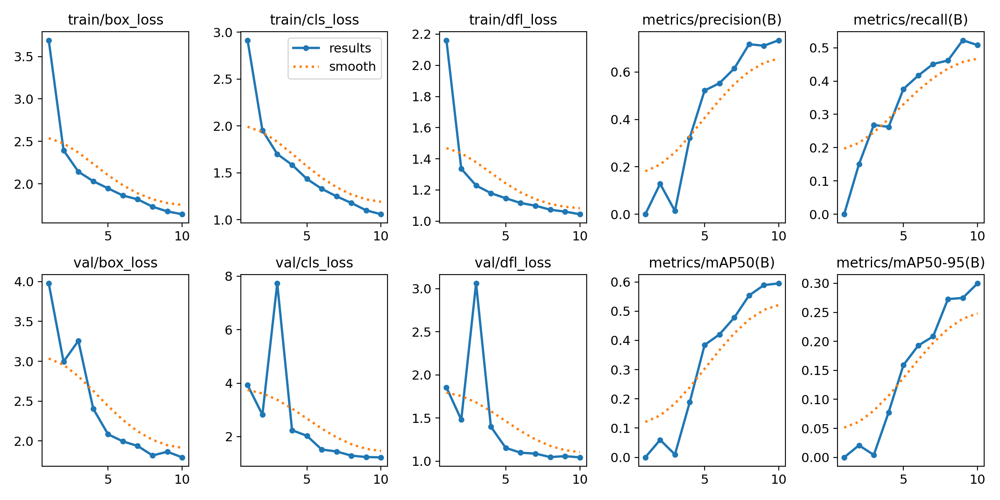

In [34]:
location = "./airplane/yolov9t_v1"
ipd.display(ipd.Image(os.path.join(location, "results.png")))

# Функция для расчёта IoU и отрисовки ошибок предсказаний модели YOLOv9

## Вспомогательные функции

In [52]:
# Вспомогательная функция для преобразования YOLO bbox к формату [x1, y1, x2, y2]
def yolo_to_xyxy(bbox, width, height):
    center_x, center_y, w, h = bbox
    x1 = (center_x - w/2) * width
    y1 = (center_y - h/2) * height
    x2 = (center_x + w/2) * width
    y2 = (center_y + h/2) * height
    return [x1, y1, x2, y2]

# Вспомогательная функция для предсказания модели YOLOv9
def get_predictions(model, image, conf_thr=0.25):
    results = model(image, verbose=False)
    predictions = []

    for idx, pred in enumerate(results[0].boxes.xyxy):
        conf = results[0].boxes.conf[idx].item()
        if conf > conf_thr:
            x1, y1, x2, y2 = pred.cpu().numpy()
            cls = results[0].boxes.cls[idx].item()
            predictions.append([x1, y1, x2, y2, int(cls)])

    return predictions

# Основная функция для отрисовки ошибок
def draw_errors(predictions, gt_bboxes, img, width, height):
    thickness = max(1, int(min(width, height) * 0.002))
    pred_color = (0, 255, 0)  # Зеленый (BGR)
    gt_color = (0, 0, 255)    # Красный (BGR)

    # Отрисовка предсказаний и GT
    for bbox in predictions:
        x1, y1, x2, y2, cls = bbox
        cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), pred_color, thickness)
        cv2.putText(img, str(cls), (int(x1), int(y1)-5), 
                  cv2.FONT_HERSHEY_SIMPLEX, 0.6, pred_color, thickness)

    for gt_bbox in gt_bboxes:
        x1, y1, x2, y2 = gt_bbox
        cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), gt_color, thickness)

    # Создаем легенду с той же шириной, что и основное изображение
    legend_height = 100
    legend = np.zeros((legend_height, width, 3), dtype=np.uint8)
    
    # Добавляем элементы легенды
    cv2.rectangle(legend, (10, 10), (50, 50), pred_color, -1)
    cv2.putText(legend, "Predicted", (60, 35), 
               cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 1)
    
    cv2.rectangle(legend, (10, 60), (50, 90), gt_color, -1)
    cv2.putText(legend, "Ground Truth", (60, 85), 
               cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 1)

    # Объединяем изображения вертикально
    img = cv2.vconcat([img, legend])
    
    return img

# Вспомогательная функция для вычисления IoU и отрисовки ошибок
def visualize_predictions(model, image_path, label_path, conf_thr=0.25):
    img = read_img(image_path, cvt_color=False)
    gt_bboxes, _ = read_label(label_path)
    height, width = img.shape[:2]

    # Преобразование GT bbox
    gt_bboxes_xyxy = [yolo_to_xyxy(bbox, width, height) for bbox in gt_bboxes]

    # Получение предсказаний
    input_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    predictions = get_predictions(model, input_img, conf_thr)

    if len(predictions) > 0 and len(gt_bboxes_xyxy) > 0:
        pred_boxes = np.array([pred[:4] for pred in predictions])
        gt_boxes = np.array(gt_bboxes_xyxy)
        
        # Вычисление IoU
        iou = box_iou(torch.tensor(pred_boxes), torch.tensor(gt_boxes))
        mean_iou = torch.max(iou, dim=1)[0].mean().item()
        print(f'\nMean IoU = {mean_iou:.2f}')

    # Отрисовка ошибок
    img_with_errors = draw_errors(predictions, gt_bboxes_xyxy, img, width, height)
    
    return img_with_errors

## Визуализируем результат предсказаний


Mean IoU = 0.60


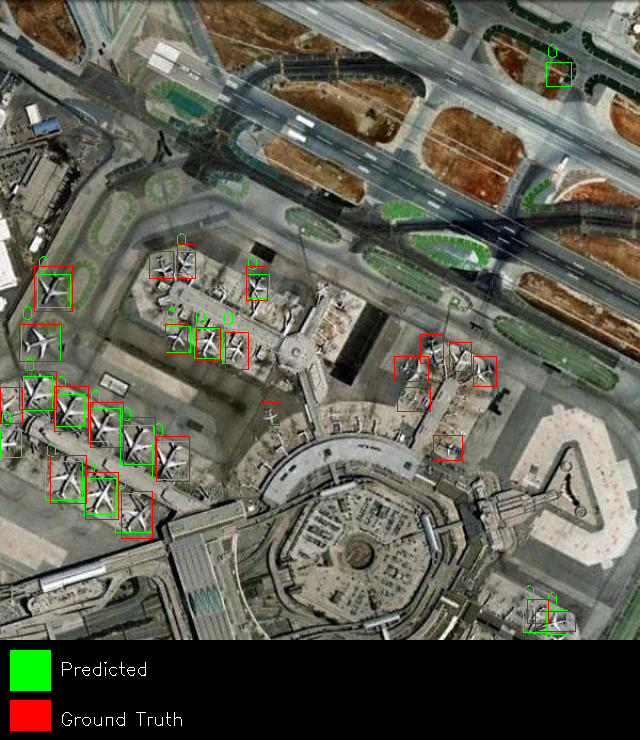

In [36]:
# Пути к тестовым данным
test_image_dir = os.path.join(dataset_path, "test/images")
test_label_dir = os.path.join(dataset_path, "test/labels")

# Получаем список тестовых изображений и аннотаций
test_images = [
    os.path.join(test_image_dir, f) 
    for f in os.listdir(test_image_dir) 
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
]

test_annotations = [
    os.path.join(test_label_dir, f.replace('.jpg', '.txt').replace('.png', '.txt'))
    for f in os.listdir(test_image_dir)
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
]

# Теперь можно использовать test_images и test_annotations
image_path = test_images[12]
label_path = test_annotations[12]

# Предобученные веса модели
model = YOLO(r'./airplane/yolov9t_v1/weights/best.pt')

# Визуализация предсказаний
img_with_errors = visualize_predictions(
    model=model,
    image_path=image_path,
    label_path=label_path,
    conf_thr=0.5  # Порог уверенности для отображения предсказаний
)

# Преобразование и отображение результата
img_rgb = cv2.cvtColor(img_with_errors, cv2.COLOR_BGR2RGB)
Image.fromarray(img_rgb)

# Применение аугментаций к обучению

## Инициализация параметров

In [37]:
# Дефолтно аугментация включена

## Инициализация модели

In [38]:
model = YOLO('yolov9t.yaml')

## Обучение модели

In [39]:
# Тренировка
result_train = model.train(data="./dataset/mydata.yaml",
                           batch=12,
                           imgsz=512,
                           save=True,
                           device=0,
                           project="airplane",
                           name="yolov9t_v2",
                           exist_ok=True,
                           optimizer="AdamW",
                           verbose=True,
                           seed=42,
                           cos_lr=False,
                           val=True,
                           plots=True,
                           workers=0,
                           epochs=10,
                           resume=False,
                           augment=False,
                           amp=False)

Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
engine\trainer: task=detect, mode=train, model=yolov9t.yaml, data=./dataset/mydata.yaml, epochs=10, time=None, patience=100, batch=12, imgsz=512, save=True, save_period=-1, cache=False, device=0, workers=0, project=airplane, name=yolov9t_v2, exist_ok=True, pretrained=True, optimizer=AdamW, verbose=True, seed=42, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=False, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

train: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\train\labels.cache... 699 images, 0

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\valid\labels.cache... 66 images, 0 ba


Plotting labels to airplane\yolov9t_v2\labels.jpg... 
optimizer: AdamW(lr=0.01, momentum=0.937) with parameter groups 221 weight(decay=0.0), 228 weight(decay=0.00046875), 227 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 512 train, 512 val
Using 0 dataloader workers
Logging results to airplane\yolov9t_v2
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      2.71G          4      3.323      2.366         45        512: 100%|██████████| 59/59 [00:22<00:00,  2.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018    0.00113     0.0216   0.000578   0.000164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      2.88G      2.686      2.352      1.405         19        512: 100%|██████████| 59/59 [00:20<00:00,  2.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018     0.0583      0.222     0.0349     0.0127



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      2.85G      2.454      2.045       1.31         47        512: 100%|██████████| 59/59 [00:19<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.196      0.249     0.0962     0.0377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      2.77G      2.311      1.944      1.271         26        512: 100%|██████████| 59/59 [00:19<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<0

                   all         66       1018      0.337      0.252      0.188     0.0821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      2.69G      2.236      1.784      1.244         66        512: 100%|██████████| 59/59 [00:19<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.449      0.317       0.32      0.137



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.76G      2.229      1.751      1.243         34        512: 100%|██████████| 59/59 [00:18<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.473      0.327      0.322      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      2.84G       2.14      1.645      1.216         68        512: 100%|██████████| 59/59 [00:18<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.447      0.278      0.261     0.0793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      2.81G      2.081      1.555      1.206         21        512: 100%|██████████| 59/59 [00:18<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.443      0.283      0.259      0.111



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      2.87G      2.046      1.509      1.182         59        512: 100%|██████████| 59/59 [00:19<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.535      0.429      0.431      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.76G      1.992      1.445      1.169         37        512: 100%|██████████| 59/59 [00:19<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.685       0.45      0.511       0.23



10 epochs completed in 0.062 hours.
Optimizer stripped from airplane\yolov9t_v2\weights\last.pt, 4.6MB
Optimizer stripped from airplane\yolov9t_v2\weights\best.pt, 4.6MB

Validating airplane\yolov9t_v2\weights\best.pt...
Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9t summary (fused): 486 layers, 1,970,979 parameters, 0 gradients, 7.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<0


                   all         66       1018      0.687       0.45      0.511       0.23
Speed: 0.4ms preprocess, 4.0ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to airplane\yolov9t_v2


## Инициализация модели с лучшим чекпоинтом

In [40]:
model = YOLO(r'./airplane/yolov9t_v2/weights/best.pt')

## Вычисляем метрики на тестовых данных

In [41]:
results_val = model.val(source="./dataset/test/images/",
                        device=0,
                        imgsz=512,
                        save=True,
                        conf=0.5,
                        iou=0.5,
                        show_labels=True,
                        augment=False)

Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9t summary (fused): 486 layers, 1,970,979 parameters, 0 gradients, 7.6 GFLOPs


val: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\valid\labels.cache... 66 images, 0 ba
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<0


                   all         66       1018      0.879      0.279      0.578      0.313
Speed: 1.1ms preprocess, 9.0ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to runs\detect\val2


## Инференс моделью

In [42]:
result_inf = model.predict(source="./dataset/test/images/",
                           device=0,
                           imgsz=512,
                           save=True,
                           conf=0.5,
                           iou=0.5,
                           show_labels=True,
                           augment=False)


image 1/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_100_jpg.rf.80d826c726c3b380162b8ddc81d7cc89.jpg: 512x512 (no detections), 20.1ms
image 2/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_104_jpg.rf.182105e032a4601dd916e04ab4092751.jpg: 512x512 1 airplane, 21.1ms
image 3/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_110_jpg.rf.e6c37b47173725a8d9db64256c24c471.jpg: 512x512 14 airplanes, 21.0ms
image 4/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_118_jpg.rf.0e0158851115f1f0c8fd317480beeada.jpg: 512x512 17 airplanes, 21.0ms
image 5/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_132_jpg.rf.3af9965ea1204733b851f03fb4f69690.jpg: 512x512 (no detections), 21.7ms
image 6/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_133_jpg.rf.

## Визуализируем графики

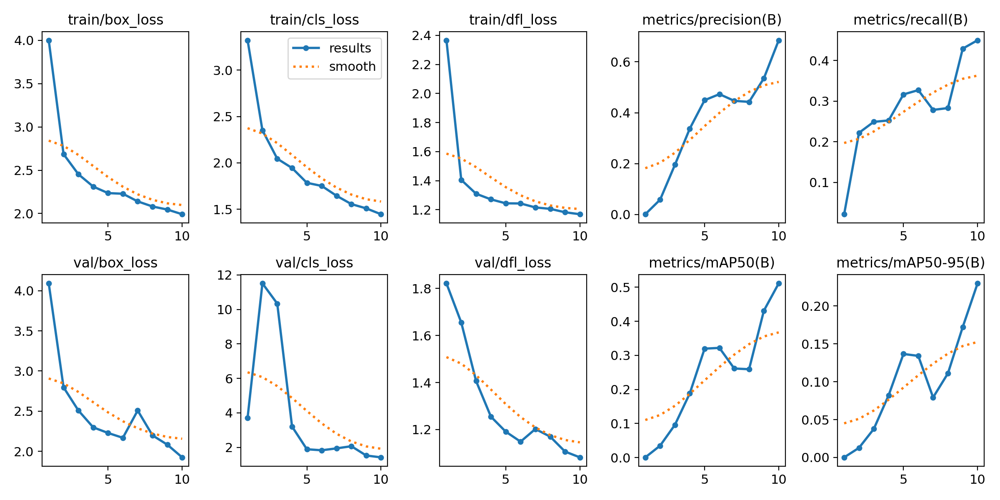

In [43]:
location = "./airplane/yolov9t_v2"
ipd.display(ipd.Image(os.path.join(location, "results.png")))

## Визуализируем результат предсказаний


Mean IoU = 0.70


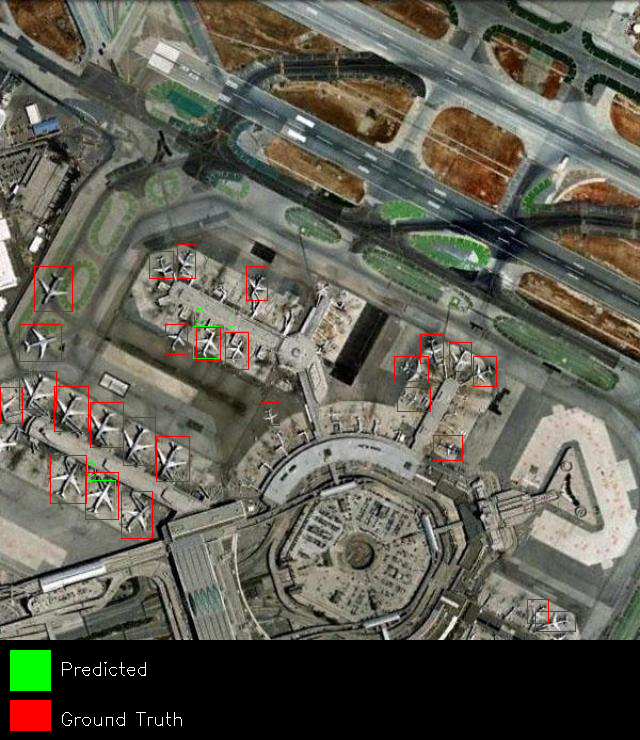

In [44]:
# Пути к тестовым данным
test_image_dir = os.path.join(dataset_path, "test/images")
test_label_dir = os.path.join(dataset_path, "test/labels")

# Получаем список тестовых изображений и аннотаций
test_images = [
    os.path.join(test_image_dir, f) 
    for f in os.listdir(test_image_dir) 
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
]

test_annotations = [
    os.path.join(test_label_dir, f.replace('.jpg', '.txt').replace('.png', '.txt'))
    for f in os.listdir(test_image_dir)
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
]

# Теперь можно использовать test_images и test_annotations
image_path = test_images[12]
label_path = test_annotations[12]

# Предобученные веса модели
model = YOLO(r'./airplane/yolov9t_v2/weights/best.pt')

# Визуализация предсказаний
img_with_errors = visualize_predictions(
    model=model,
    image_path=image_path,
    label_path=label_path,
    conf_thr=0.5  # Порог уверенности для отображения предсказаний
)

# Преобразование и отображение результата
img_rgb = cv2.cvtColor(img_with_errors, cv2.COLOR_BGR2RGB)
Image.fromarray(img_rgb)

# Тюнинг гиперпараметров

## Инициализация параметров

In [34]:
# search_space = {
#     "hsv_h":  (0, 0),
#     "hsv_s":  (0, 0),
#     "hsv_v":  (0, 0),
#     "degrees":  (0, 0),
#     "fliplr":  (0, 0),
#     "mosaic":  (0, 0),
#     "mixup":  (0, 0),
#     "translate": (0, 0),
#     "scale": (0, 0),
#     "shear": (0, 0),
#     "perspective": (0, 0),
#     "flipud": (0, 0),
#     "bgr": (0, 0),
#     "copy_paste": (0, 0),
#     "erasing": (0, 0),
#     "crop_fraction": (0, 0),
#     "lr0": (1e-5, 1e-1),
#     "cls": (0.2, 4),
#     "box": (0.02, 0.2),
#     "warmup_momentum": (0, 0.95),
#     "warmup_epochs": (0, 5),
#     "weight_decay": (0, 0.001),
#     "momentum": (0.6, 0.98),
#     "lrf": (0.01, 1.0)
# }

## Инициализация модели

In [35]:
# model = YOLO('yolov9t.yaml')

## Тюнинг модели

In [36]:
# # Тренировка
# result_tune = model.tune(data="./dataset/mydata.yaml",
#                          batch=12,
#                          imgsz=512,
#                          save=True,
#                          device=0,
#                          project="airplane",
#                          name="yolov9t_tune",
#                          exist_ok=True,
#                          verbose=True,
#                          seed=42,
#                          val=False,
#                          plots=True,
#                          workers=0,
#                          epochs=3,
#                          space=search_space,
#                          iterations=10)

Tuner: Initialized Tuner instance with 'tune_dir=airplane\yolov9t_tune'
Tuner:  Learn about tuning at https://docs.ultralytics.com/guides/hyperparameter-tuning
Tuner: Starting iteration 1/10 with hyperparameters: {'hsv_h': 0, 'hsv_s': 0, 'hsv_v': 0, 'degrees': 0.0, 'fliplr': 0, 'mosaic': 0, 'mixup': 0.0, 'translate': 0, 'scale': 0, 'shear': 0.0, 'perspective': 0.0, 'flipud': 0.0, 'bgr': 0.0, 'copy_paste': 0.0, 'erasing': 0, 'crop_fraction': 0, 'lr0': 0.01, 'cls': 0.5, 'box': 0.2, 'warmup_momentum': 0.8, 'warmup_epochs': 3.0, 'weight_decay': 0.0005, 'momentum': 0.937, 'lrf': 0.01}
Saved airplane\yolov9t_tune\tune_scatter_plots.png
Saved airplane\yolov9t_tune\tune_fitness.png

Tuner: 1/10 iterations complete  (87.68s)
Tuner: Results saved to airplane\yolov9t_tune
Tuner: Best fitness=0.05438 observed at iteration 1
Tuner: Best fitness metrics are {'metrics/precision(B)': 0.30299, 'metrics/recall(B)': 0.18075, 'metrics/mAP50(B)': 0.12231, 'metrics/mAP50-95(B)': 0.04683, 'val/box_loss': 0.0

## Смотрим на затюненные параметры

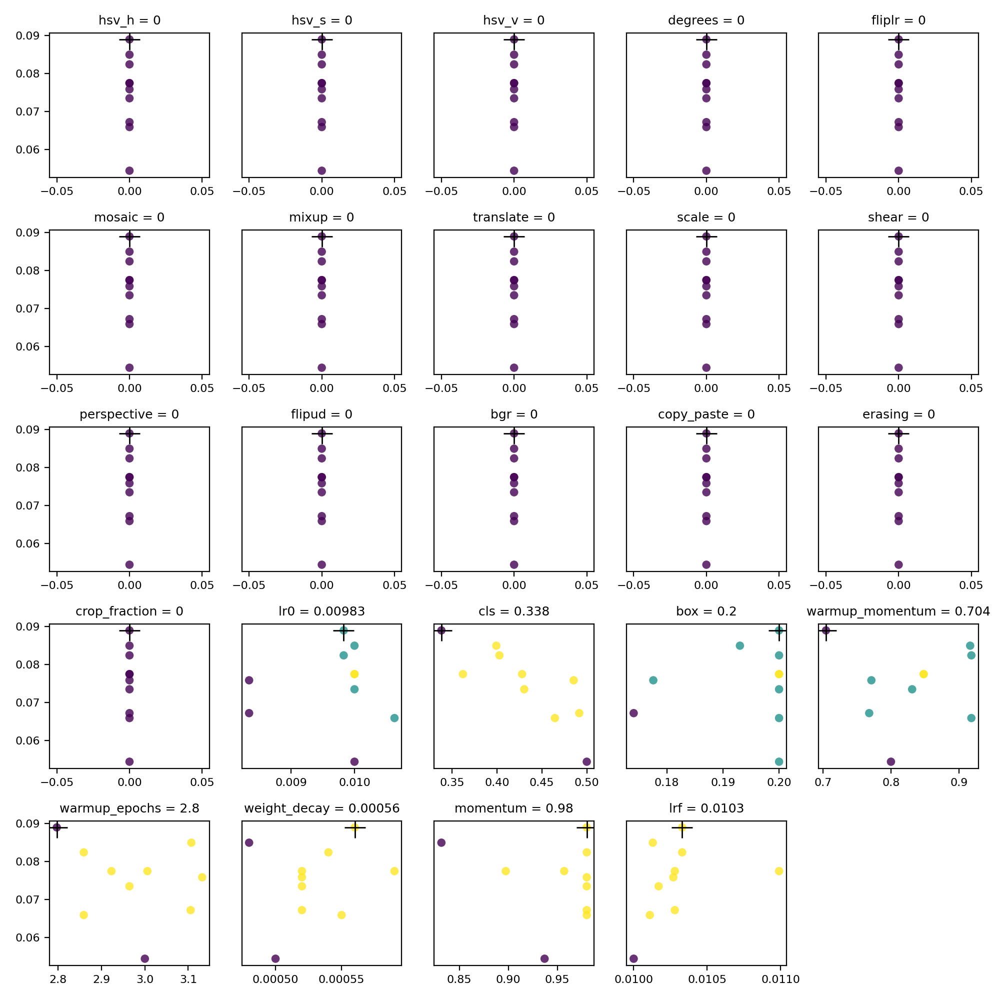

In [39]:
location = "./airplane/yolov9t_tune"
ipd.display(ipd.Image(os.path.join(location, "tune_scatter_plots.png")))

### Инициализируем найденые гиперпараметры

In [44]:
augm = {
    "hsv_h":  0,
    "hsv_s":  0,
    "hsv_v":  0,
    "degrees":  0,
    "fliplr":  0,
    "mosaic":  0,
    "mixup":  0,
    "translate": 0,
    "scale": 0,
    "shear": 0,
    "perspective": 0,
    "flipud": 0,
    "bgr": 0,
    "copy_paste": 0,
    "erasing": 0,
    "crop_fraction": 0,
    "lr0": 0.00983,
    "cls": 0.338,
    "box": 0.2,
    "warmup_momentum": 0.704,
    "warmup_epochs": 2.8,
    "weight_decay": 0.00056,
    "momentum": 0.98,
    "lrf": 0.0103
}

## Инициализируем модель

In [45]:
model = YOLO('yolov9t.yaml')

## Обучаем модель

In [46]:
# Тренировка
result_train = model.train(data="./dataset/mydata.yaml",
                           batch=12,
                           imgsz=512,
                           save=True,
                           device=0,
                           project="airplane",
                           name="yolov9t_v3",
                           exist_ok=True,
                           optimizer="AdamW",
                           verbose=True,
                           seed=42,
                           cos_lr=False,
                           val=True,
                           plots=True,
                           workers=0,
                           epochs=10,
                           resume=False,
                           augment=False,
                           amp=False,
                           **augm)

Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
engine\trainer: task=detect, mode=train, model=yolov9t.yaml, data=./dataset/mydata.yaml, epochs=10, time=None, patience=100, batch=12, imgsz=512, save=True, save_period=-1, cache=False, device=0, workers=0, project=airplane, name=yolov9t_v3, exist_ok=True, pretrained=True, optimizer=AdamW, verbose=True, seed=42, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=False, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

train: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\train\labels.cache... 699 images, 0

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\valid\labels.cache... 66 images, 0 ba


Plotting labels to airplane\yolov9t_v3\labels.jpg... 
optimizer: AdamW(lr=0.00983, momentum=0.98) with parameter groups 221 weight(decay=0.0), 228 weight(decay=0.000525), 227 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 512 train, 512 val
Using 0 dataloader workers
Logging results to airplane\yolov9t_v3
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      3.46G     0.1087      2.009      2.238         47        512: 100%|██████████| 59/59 [00:18<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018    0.00116     0.0118   0.000588   0.000161



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      3.01G    0.06978      1.334      1.378         22        512: 100%|██████████| 59/59 [00:17<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018   0.000505    0.00982   0.000265   8.61e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      3.01G     0.0619      1.199      1.259         47        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018    0.00162     0.0314   0.000834   0.000359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      3.11G    0.05883      1.109      1.227         26        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018     0.0135      0.207    0.00769    0.00327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      3.01G    0.05608      1.027       1.19         71        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018     0.0954      0.199     0.0387     0.0142



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      2.92G    0.05425     0.9484      1.169         34        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.451      0.317      0.296      0.123



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         3G    0.05271     0.9031      1.151         68        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.543      0.385      0.394      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      3.01G     0.0512     0.8555      1.132         24        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.602      0.459      0.499      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         3G    0.05048     0.8333      1.121         63        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.635      0.484      0.514      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      2.98G    0.04997     0.8051      1.112         45        512: 100%|██████████| 59/59 [00:16<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<0

                   all         66       1018      0.641      0.507       0.55      0.255



10 epochs completed in 0.055 hours.
Optimizer stripped from airplane\yolov9t_v3\weights\last.pt, 4.6MB
Optimizer stripped from airplane\yolov9t_v3\weights\best.pt, 4.6MB

Validating airplane\yolov9t_v3\weights\best.pt...
Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9t summary (fused): 486 layers, 1,970,979 parameters, 0 gradients, 7.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<0


                   all         66       1018      0.641      0.507       0.55      0.255
Speed: 0.4ms preprocess, 5.0ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to airplane\yolov9t_v3


## Инициализация модели с лучшим чекпоинтом

In [47]:
model = YOLO(r'./airplane/yolov9t_v3/weights/best.pt')

## Вычисляем метрики на тестовых данных

In [48]:
results_val = model.val(source="./dataset/test/images/",
                        device=0,
                        imgsz=512,
                        save=True,
                        conf=0.5,
                        iou=0.5,
                        show_labels=True,
                        augment=False)

Ultralytics 8.3.71  Python-3.9.16 torch-2.6.0+cu118 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)
YOLOv9t summary (fused): 486 layers, 1,970,979 parameters, 0 gradients, 7.6 GFLOPs


val: Scanning C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\valid\labels.cache... 66 images, 0 ba
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:04<0


                   all         66       1018      0.852      0.386      0.628      0.342
Speed: 1.2ms preprocess, 7.5ms inference, 0.0ms loss, 5.8ms postprocess per image
Results saved to runs\detect\val3


## Инференс моделью

In [49]:
result_inf = model.predict(source="./dataset/test/images/",
                           device=0,
                           imgsz=512,
                           save=True,
                           conf=0.5,
                           iou=0.5,
                           show_labels=True,
                           augment=False)


image 1/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_100_jpg.rf.80d826c726c3b380162b8ddc81d7cc89.jpg: 512x512 (no detections), 36.2ms
image 2/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_104_jpg.rf.182105e032a4601dd916e04ab4092751.jpg: 512x512 2 airplanes, 110.0ms
image 3/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_110_jpg.rf.e6c37b47173725a8d9db64256c24c471.jpg: 512x512 18 airplanes, 25.1ms
image 4/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_118_jpg.rf.0e0158851115f1f0c8fd317480beeada.jpg: 512x512 18 airplanes, 20.0ms
image 5/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_132_jpg.rf.3af9965ea1204733b851f03fb4f69690.jpg: 512x512 (no detections), 35.1ms
image 6/34 C:\Users\NightMare\PycharmProjects\CVtools\ElectiveWork\HW2\dataset\test\images\airport_133_jpg.r

## Визуализируем графики

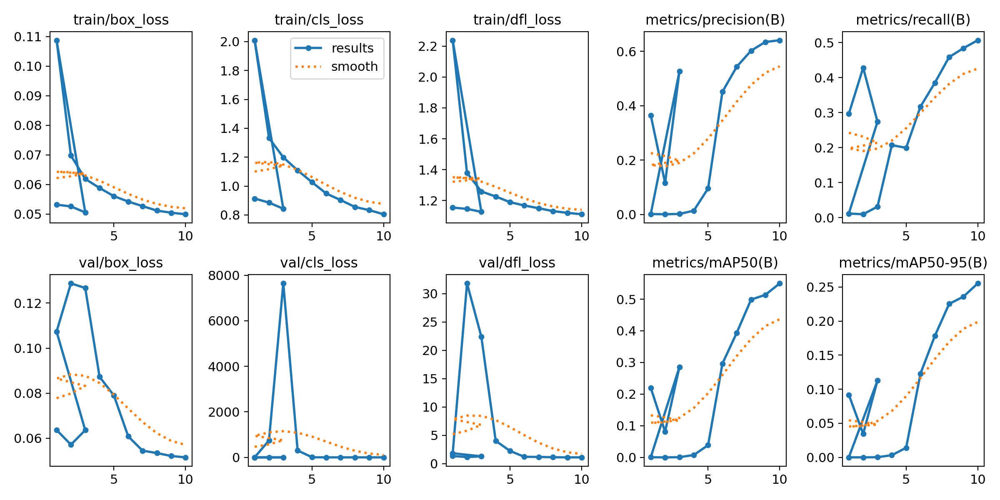

In [50]:
location = "./airplane/yolov9t_v3"
ipd.display(ipd.Image(os.path.join(location, "results.png")))

## Визуализируем результат предсказаний


Mean IoU = 0.48


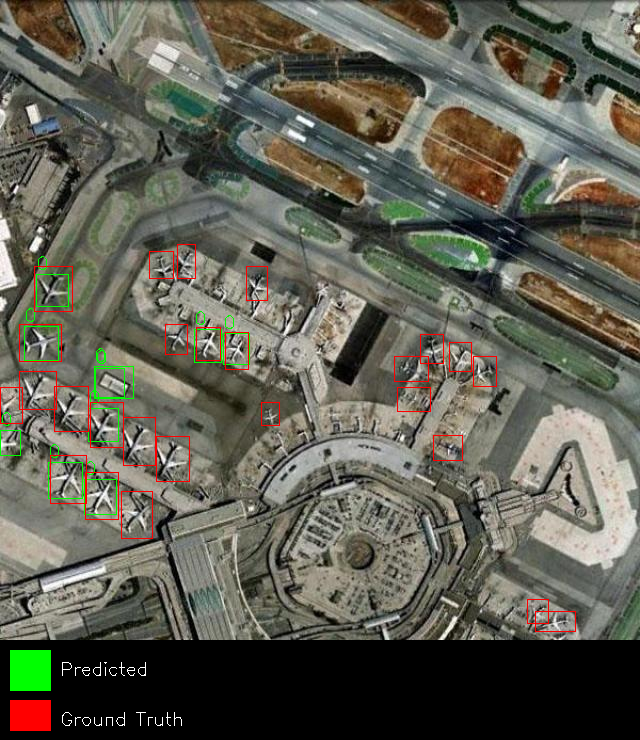

In [53]:
# Пути к тестовым данным
test_image_dir = os.path.join(dataset_path, "test/images")
test_label_dir = os.path.join(dataset_path, "test/labels")

# Получаем список тестовых изображений и аннотаций
test_images = [
    os.path.join(test_image_dir, f) 
    for f in os.listdir(test_image_dir) 
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
]

test_annotations = [
    os.path.join(test_label_dir, f.replace('.jpg', '.txt').replace('.png', '.txt'))
    for f in os.listdir(test_image_dir)
    if f.lower().endswith(('.png', '.jpg', '.jpeg'))
]

# Теперь можно использовать test_images и test_annotations
image_path = test_images[12]
label_path = test_annotations[12]

# Предобученные веса модели
model = YOLO(r'./airplane/yolov9t_v3/weights/best.pt')

# Визуализация предсказаний
img_with_errors = visualize_predictions(
    model=model,
    image_path=image_path,
    label_path=label_path,
    conf_thr=0.5  # Порог уверенности для отображения предсказаний
)

# Преобразование и отображение результата
img_rgb = cv2.cvtColor(img_with_errors, cv2.COLOR_BGR2RGB)
Image.fromarray(img_rgb)

# Улучшение модели добавлением новых данных

# Заключительный проект

# Выводы

<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">

<pre style="background-color: #888888; padding: 10px; border-radius: 5px; font-family: monospace;">
    <span style="color: white;">
        
    </span>
</pre>

<hr style="border: 1px solid rgba(50, 50, 255, 0.5); width: 100%;">